sentence_clusterssentence_clusters [[['Krass das habe ich noch nie gesehen', 'Krass'], ['Krass wie schnell du das geschafft hast', 'Krass'], ['Krass das war wirklich beeindruckend', 'Krass']], [['Das war eine krass schwierige Entscheidung', 'krass'], ['Er hatte eine krass interessante Idee', 'krass'], ['Die krasse VerÃ¤nderung hat alle Ã¼berrascht', 'krasse']], [['Die Party war krass gut organisiert', 'krass'], ['Er hat das krass schnell erledigt', 'krass'], ['Sie war krass begeistert von dem Ergebnis', 'krass'], ['Der Vortrag war krass langweilig', 'krass']]]
sentence_clusterssentence_clusters [[('Wow <ROOT> Geschichte oder', 'krasse')], [('Was du siehst sind zwei <ROOT> Rapper', 'krasse')], [('statt Schuhe <ROOT> Butterfly', 'krassen')], [('Ja im Gewichtheben ganz <ROOT> also das ist nicht mehr schön –', 'krass')], [('Du bist richtig gut drauf Geht’s dir gut Ja mir geht s gut Also ich fand’s richtig <ROOT>', 'krass')]]
sentences_dictsentences_dict defaultdict(<class 'list'>, {'krass'

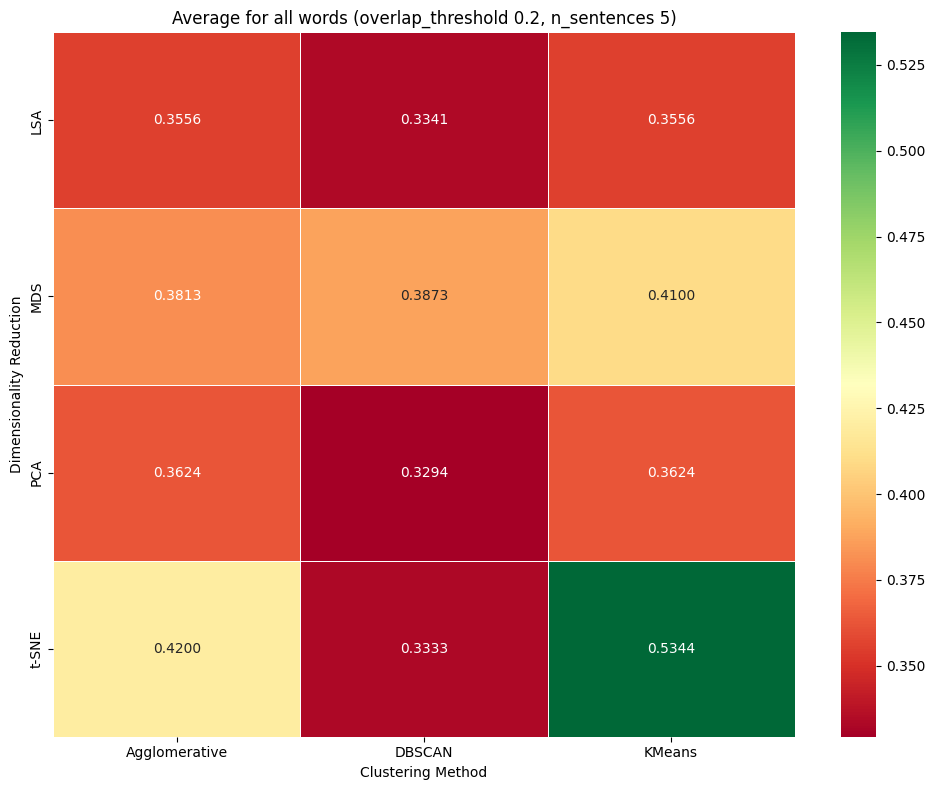

sentence_clusterssentence_clusters [[['Krass das habe ich noch nie gesehen', 'Krass'], ['Krass wie schnell du das geschafft hast', 'Krass'], ['Krass das war wirklich beeindruckend', 'Krass']], [['Das war eine krass schwierige Entscheidung', 'krass'], ['Er hatte eine krass interessante Idee', 'krass'], ['Die krasse VerÃ¤nderung hat alle Ã¼berrascht', 'krasse']], [['Die Party war krass gut organisiert', 'krass'], ['Er hat das krass schnell erledigt', 'krass'], ['Sie war krass begeistert von dem Ergebnis', 'krass'], ['Der Vortrag war krass langweilig', 'krass']]]
sentence_clusterssentence_clusters [[('Er hat die <ROOT> gemacht die Beine noch hochgestellt', 'krassen')], [('Klingt im ersten Moment ein bisschen <ROOT> aber viele Milliardäre bereiten sich aktiv', 'krass')], [('dich turnt wie <ROOT> wir betonen', 'krass')], [('Da ist das Licht angegangen Das funktioniert echt Total <ROOT>', 'krass')], [('<ROOT> danke - Bitte', 'krass')], [('Und natürlich denkt man sich dann auch Oh <ROOT> ich 

In [1]:
import numpy as np
from collections import defaultdict, deque
import re

class Node:
    def __init__(self, word, id):
        self.word = word
        self.id = id
        self.count = 0
        self.children = {}


class PatternExtractor:
    def __init__(self):
        self.preceding_tree = Node('<ROOT>', 0)
        self.following_tree = Node('<ROOT>', 1)
        self.node_counter = 2
        self.word_to_preceding_ids = defaultdict(list)
        self.word_to_following_ids = defaultdict(list)
        self.id_to_node = {0: self.preceding_tree, 1: self.following_tree}
        self.child_to_parents = defaultdict(list)
        self.node_embeddings = {}  # Store embeddings for each node

    def add_start_end_flags_lower(self, sentences):
        # res = []
        # for sentence in sentences:
        #     res.append(re.sub(r'[^a-zA-Z\säüö]', '', sentence))
        return [f"<START> {sentence} <END>" for sentence in sentences]

    def get_or_create_node(self, current_tree, word, parent_id, direction):
        word_to_ids = self.word_to_preceding_ids if direction == 'preceding' else self.word_to_following_ids
        if word not in current_tree.children:
            new_node = Node(word, self.node_counter)
            current_tree.children[word] = new_node
            word_to_ids[word].append(self.node_counter)
            self.id_to_node[self.node_counter] = new_node
            if parent_id is not None:
                self.child_to_parents[self.node_counter].append(parent_id)
            self.node_counter += 1
        else:
            child_id = current_tree.children[word].id
            if parent_id is not None:
                self.child_to_parents[child_id].append(parent_id)
        return current_tree.children[word]

    def add_to_tree(self, words, direction, count=1):
        if direction == 'preceding':
            current_tree = self.preceding_tree
            word_range = range(len(words) - 1, -1, -1)
        else:
            current_tree = self.following_tree
            word_range = range(len(words))

        parent_id = current_tree.id

        for i in word_range:
            current_word = words[i]
            current_tree = self.get_or_create_node(current_tree, current_word, parent_id, direction)
            current_tree.count += count
            parent_id = current_tree.id

    def create_tree_mask_as_root(self, sentences_dict):
        print("sentences_dictsentences_dict",sentences_dict)
        for morphology, sentences_and_ids in sentences_dict.items():
            print("sentences_and_ids", sentences_and_ids)
            sentences_with_flags = self.add_start_end_flags_lower([sentence for id, sentence in sentences_and_ids])
            print("sentences_with_flags",sentences_with_flags)
            for sentence in sentences_with_flags:
                words = sentence.split()
                print("words",words)
                key_word_index = words.index('<ROOT>')
                print("key_word_index",key_word_index)
                words_before = words[:key_word_index]
                words_after = words[key_word_index + 1:]

                self.add_to_tree(words_before, 'preceding')
                self.add_to_tree(words_after, 'following')

    def print_tree(self, node, level=0):
        print('  ' * level + f"{node.word} (count: {node.count}, id: {node.id})")
        for child in node.children.values():
            self.print_tree(child, level + 1)

    def print_trees(self):
        print("Preceding Tree (before <ROOT>):")
        self.print_tree(self.preceding_tree)
        print("\nFollowing Tree (after <ROOT>):")
        self.print_tree(self.following_tree)

    def get_nodes_by_word(self, word, direction):
        word_to_ids = self.word_to_preceding_ids if direction == 'preceding' else self.word_to_following_ids
        ids = word_to_ids.get(word, [])
        return {self.id_to_node[id] for id in ids}

    def get_parents_by_id(self, id):
        parent_ids = self.child_to_parents.get(id, [])
        return [self.id_to_node[parent_id] for parent_id in parent_ids]

    def optimize_tree(self, word, direction, overlap_threshold=1, visited=None, revisit_queue=None):
        if visited is None:
            visited = set()
        if revisit_queue is None:
            revisit_queue = set()

        word_to_ids = self.word_to_preceding_ids if direction == 'preceding' else self.word_to_following_ids

        all_nodes = self.get_nodes_by_word(word, direction)
        groups_with_overlap_children = []
        parent_node_ids = []

        node_changed = False

        for node in all_nodes:
            if node.id in visited and node.id not in revisit_queue:
                continue  # Skip already visited nodes unless they're in the revisit queue
            visited.add(node.id)  # Mark the node as visited

            parent_node_ids.extend(self.child_to_parents[node.id])

            if word in ['<START>', '<END>']:
                if not groups_with_overlap_children:
                    groups_with_overlap_children.append({
                        'combined_structure': None,
                        'nodes': [node]
                    })
                else:
                    groups_with_overlap_children[-1]['nodes'].append(node)
                continue

            # Extract child and parent structures for comparison
            child_structure = frozenset(child.word for child in node.children.values())  # Use frozenset for comparison
            parent_structure = set(parent.word for parent in self.get_parents_by_id(node.id))
            combined_structure = child_structure.union(parent_structure)

            added_to_group = False
            for group in groups_with_overlap_children:
                group_structure = group['combined_structure']
                intersection = combined_structure.intersection(group_structure)
                if len(combined_structure) > 0 and len(group_structure) > 0:
                    overlap_ratio_combined_structure = len(intersection) / len(combined_structure)
                    overlap_ratio_group_structure = len(intersection) / len(group_structure)
                    if overlap_ratio_combined_structure >= overlap_threshold or overlap_ratio_group_structure >= overlap_threshold:
                        group['nodes'].append(node)
                        group['combined_structure'] = group['combined_structure'].union(combined_structure)
                        added_to_group = True
                        break

            if not added_to_group:
                groups_with_overlap_children.append({
                    'combined_structure': combined_structure,
                    'nodes': [node]
                })

        # Handle node merging
        new_nodes = []
        for node_group in [group['nodes'] for group in groups_with_overlap_children if len(group['nodes']) > 1]:
            node_with_smallest_id = min(node_group, key=lambda node: node.id)
            new_nodes.append(node_with_smallest_id)
            for node in node_group:
                if node != node_with_smallest_id:  # node is duplicate
                    node_with_smallest_id.children.update(node.children)  # Adopt children

                    # If children have changed, mark the node as modified
                    node_changed = True

                    # Remove from id_to_node
                    self.id_to_node.pop(node.id)
                    # Remove from word_to_ids
                    word_to_ids[word].remove(node.id)
                    # Remove from child_to_parents, merge parents list with new main node
                    parent_ids = self.child_to_parents.pop(node.id)
                    for parent_id in parent_ids:
                        if parent_id not in self.child_to_parents[node_with_smallest_id.id]:
                            self.child_to_parents[node_with_smallest_id.id].append(parent_id)
                        # Update parent node's reference to the new node
                        if word in self.id_to_node.get(parent_id).children:
                            self.id_to_node.get(parent_id).children[word] = node_with_smallest_id

                    # Update children's parent references
                    for child_node in node.children.values():
                        self.child_to_parents[child_node.id].remove(node.id)
                        if node_with_smallest_id.id not in self.child_to_parents[child_node.id]:
                            self.child_to_parents[child_node.id].append(node_with_smallest_id.id)

        # If any node was changed, mark the parent nodes for revisit
        if node_changed:
            revisit_queue.update(set(parent_node_ids))

        # Process the parent nodes and optimize their trees
        for node_id in set(parent_node_ids):
            if node_id in self.id_to_node:
                self.optimize_tree(self.id_to_node[node_id].word, direction, overlap_threshold=overlap_threshold, visited=visited, revisit_queue=revisit_queue)

    def initialize_node_embeddings(self, embedding_size=100):
        """
        Initialize random embeddings for each node.
        """
        for node_id in self.id_to_node.keys():
            self.node_embeddings[node_id] = np.random.rand(embedding_size)

    def compute_weighted_sentence_embedding(self, sentence_path, weighting_scheme = None):
        """
        Compute a weighted sentence embedding by traversing the sentence path.
        Nodes closer to the root are weighted more heavily.
        """
        print("self.node_embeddings",self.node_embeddings)
        weighted_embedding = np.zeros(len(self.node_embeddings[0]))  # Assuming all embeddings have the same size
        for i, node_id in enumerate(sentence_path):
            if weighting_scheme == 'linear':
                distance_from_root = i + 1
                weight = 1 / distance_from_root
            elif weighting_scheme == 'inverse_sigmoid':
                distance_from_root = i + 1  # Assuming sentence_path is ordered from ROOT
                steepness = 1
                weight = 1 - (1 / (1 + np.exp(-steepness * distance_from_root)))
            else:
                weight = 1
            weighted_embedding += weight * self.node_embeddings[node_id]
        return weighted_embedding / len(sentence_path)

    def get_sentence_embedding(self, sentence, morphology, weighting_scheme = None):
        """
        Given a sentence, return its corresponding embedding.
        """

        words = sentence.split()
        node_path = deque([0])
        print("words",words)
        key_word_index = words.index('<ROOT>')
        words_before = words[:key_word_index]
        words_after = words[key_word_index + 1:]

        current_node = self.preceding_tree
        for i in range(len(words_before) - 1, -1, -1):
            word = words_before[i]
            print("WORD",word)
            print("current_node.children",current_node.children)
            if word in current_node.children:
                current_node = current_node.children[word]
                node_path.appendleft(current_node.id)
            else:
                raise

        current_node = self.following_tree
        for word in words_after:
            if word in current_node.children:
                print("WORD",[word])
                print("current_node.children",current_node.children)
                current_node = current_node.children[word]
                node_path.append(current_node.id)
            else:
                raise
        return self.compute_weighted_sentence_embedding(node_path, weighting_scheme=weighting_scheme)

    def get_all_sentence_embeddings(self, sentences_dict, weighting_scheme=None):
        """
        Generate embeddings for all sentences in the dataset.
        """
        sentence_embeddings = []
        sentence_list = []
        for morphology, sentences_and_ids in sentences_dict.items():
            print("sentences_and_ids", sentences_and_ids)
            sentences_with_flags = self.add_start_end_flags_lower([sentence for id, sentence in sentences_and_ids])
            for sentence in sentences_with_flags:
                embedding = self.get_sentence_embedding(sentence, morphology, weighting_scheme=weighting_scheme)
                sentence_embeddings.append(embedding)
                sentence_list.append(sentence)
        return np.array(sentence_embeddings), sentence_list

    def initialize(self, sentences_dict, overlap_threshold = 1):
        self.create_tree_mask_as_root(sentences_dict)
        self.optimize_tree('<START>', 'preceding', overlap_threshold=overlap_threshold)
        self.optimize_tree('<END>', 'forward', overlap_threshold=overlap_threshold)


sentences_dict = {
    'erinnert': [
        'sie <ROOT> an ein Gespräch',
        'er <ROOT> gerne an die Vergangenheit'
    ],
}

import numpy as np
from collections import defaultdict
from melon_clustering import PatternExtractorOneHot, ClusterEvaluator, ClusterManager, Loader, reference_clusters_de

dim_reduction_methods = ['LSA', 'PCA', 't-SNE', 'MDS']
clustering_methods = ['KMeans', 'Agglomerative', 'DBSCAN']
cluster_manager = ClusterManager()

for overlap_threshold in [0.2, 0.4, 0.6, 0.8, 1]:
# for overlap_threshold in [0.2]:
    for n_sentences in [5, 50, 500, 5000]:
    # for n_sentences in [5]:
        all_results_dfs = []
        for ref_word, reference_clusters in reference_clusters_de.items():
            additional_sentences_dict = Loader.load_sentences_from_word(ref_word, 'de', n_sentences=n_sentences)
            evaluator = ClusterEvaluator(reference_clusters=reference_clusters)
            sentences_dict_ref = evaluator.add_reference_sentences(reference_clusters)
            sentences_dict_db = evaluator.add_additional_sentences(additional_sentences_dict)

            extractor = PatternExtractor()
            extractor.initialize(evaluator.sentences_dict, overlap_threshold = 0.6)
            extractor.initialize_node_embeddings()
            extractor.print_trees()

            embeddings, sentences_list = extractor.get_all_sentence_embeddings(evaluator.sentences_dict)

            vectors_reference = evaluator.isolate_reference_embeddings(embeddings, num_additional_sentences=len(sentences_dict_db['krass']))
            reference_sentence_ids = sorted(evaluator.reference_sentence_ids)
            reference_sentence_paths = [(sid, evaluator.sentence_id_to_original[sid]) for sid in reference_sentence_ids]

            clustering_results = cluster_manager.run_all_configurations(
                vectors=vectors_reference,
                dim_methods=dim_reduction_methods,
                cluster_methods=clustering_methods,
                sentence_paths=reference_sentence_paths,
                plot_seaborn=False,
                plot_plt=False,
                annotate_plt=True
            )

            results_df = evaluator.evaluate_multiple_configurations(clustering_results, ref_word, plot = False,
                                                                    overlap_threshold=str(overlap_threshold), n_sentences=str(n_sentences))
            all_results_dfs.append(results_df)

        if all_results_dfs:
            evaluator.plot_average_similarity_heatmap(all_results_dfs, 'Average for all words', plot = True, save=True,
                                                      overlap_threshold=str(overlap_threshold), n_sentences=str(n_sentences))